In [1]:
import os
import datetime
import requests
import PIL

from IPython.display import display

In [2]:
def get_file(path: str, save_file_name=None):
  if path.startswith("http"):
    try:
      headers = {
              "User-Agent": "Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/91.0.4472.124 Safari/537.36"
          }
      res = requests.get(path, headers=headers)
      res.raise_for_status()  # Raise an error for bad responses (e.g., 404)
      content = res.content
      save_file_name = save_file_name or datetime.datetime.now().strftime("%d%m%y_%H%M%S%f") + "." + path.split(".")[-1]
      with open(save_file_name, "wb") as fp:
        fp.write(content)
      return save_file_name
    except requests.exceptions.HTTPError as http_err:
        raise Exception(f"HTTP error occurred: {http_err}")
    except Exception as err:
        raise Exception(f"Error occurred: {err}")
  else:
    print("URL invalid. Only the HTTP protocol is allowed.")
    raise Exception("Getting error with path: Please use `wget url` in bash to download file ")


In [3]:
image_path1 = get_file("https://images.all-free-download.com/images/graphicwebp/beautiful_natural_scenery_553758.webp")

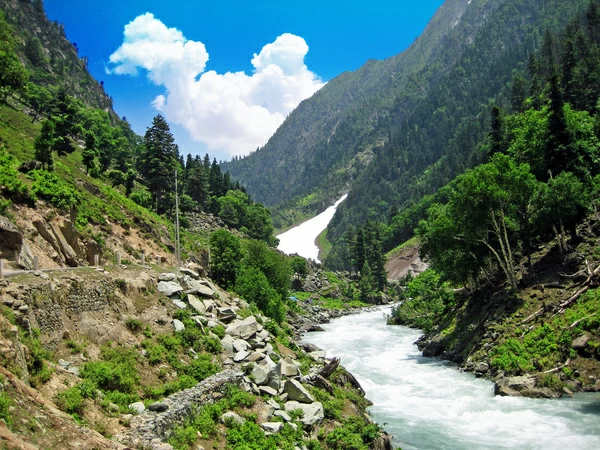

In [4]:
original_image = PIL.Image.open(image_path1)
# show actual image
# original_image.show()
original_image

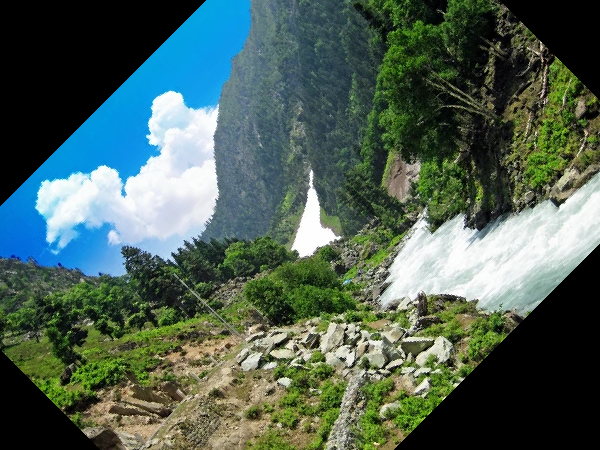

In [5]:
# rotate image
rotate_image = original_image.rotate(45)
rotate_image

In [6]:
print("Filename of image: ", original_image.filename)
print("Format of image: ", original_image.format)
print("Format description of image: ", original_image.format_description)
print("Image filepointer: ", original_image.fp)
print("Image Mode: ", original_image.mode)
print("Image size: ", original_image.size)
print("Info about image: ", original_image.info)

Filename of image:  140923_125802710536.webp
Format of image:  WEBP
Format description of image:  WebP image
Image filepointer:  None
Image Mode:  RGB
Image size:  (600, 450)
Info about image:  {'loop': 1, 'background': (255, 255, 255, 255), 'timestamp': 0, 'duration': 0}


## **Splitting image**
Modes: [modes and bands docs](https://pillow.readthedocs.io/en/stable/handbook/concepts.html)

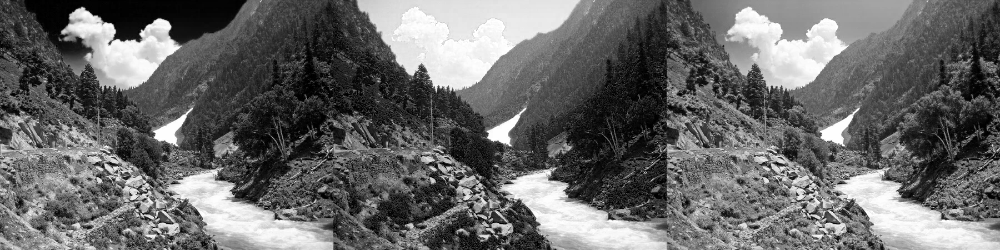

In [7]:
# Splitting and merging bands.
# see image mode to see unpacking image
(r, b, g) = original_image.split()
'''
Show image side by side
'''
# Get the dimensions of the images
width, height = r.size

# Create a new image with triple the width for horizontal concatenation
combined_image = PIL.Image.new('RGB', (width * 3, height))

# Paste the images side by side
combined_image.paste(r, (0, 0))
combined_image.paste(g, (width, 0))
combined_image.paste(b, (2 * width, 0))

# Display the combined image
display(combined_image)

## **Merging image**

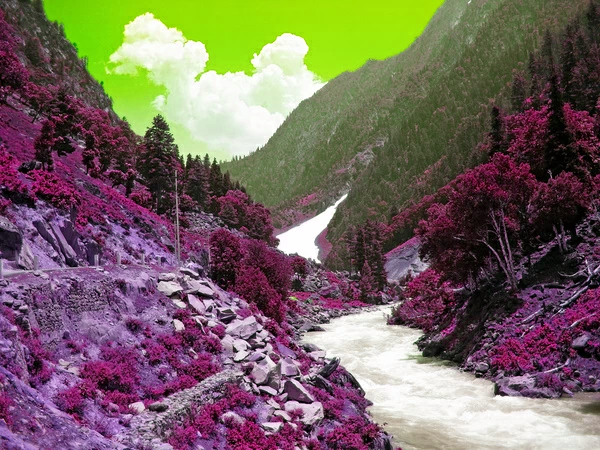

In [8]:
merged_image_bgr = PIL.Image.merge("RGB", (b, g, r))
merged_image_bgr

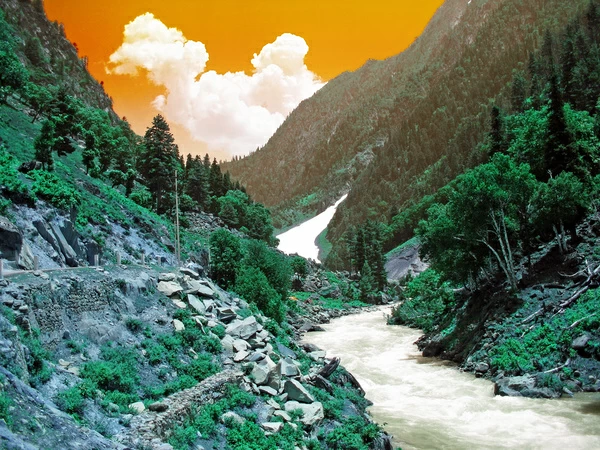

In [9]:
merged_image_gbr = PIL.Image.merge("RGB", (g, b, r))
merged_image_gbr

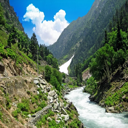

In [10]:
# resized image
resized_image = original_image.resize((128, 128))
resized_image

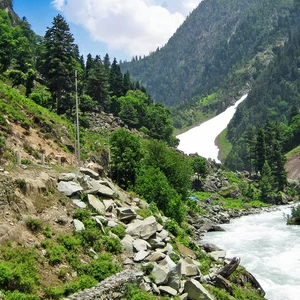

In [11]:
# 4-tuple, where coordinates are (left, upper, right, lower)
box = (100, 100, 400, 400)
region = original_image.crop(box=box)
region

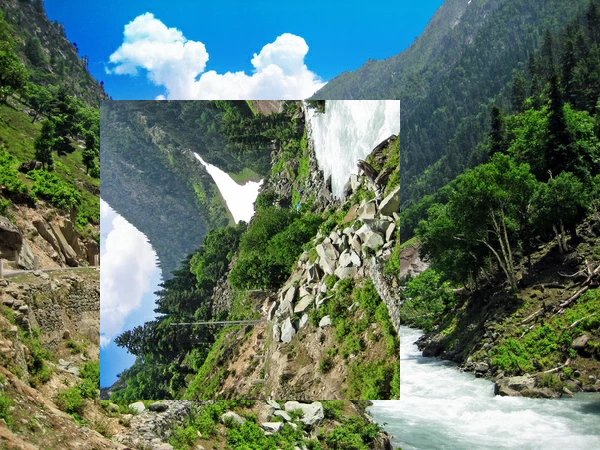

In [12]:
region = region.transpose(PIL.Image.Transpose.ROTATE_90)
# Processing a subrectangle, and pasting it back
original_image.paste(region, box)
original_image

Mode:  L


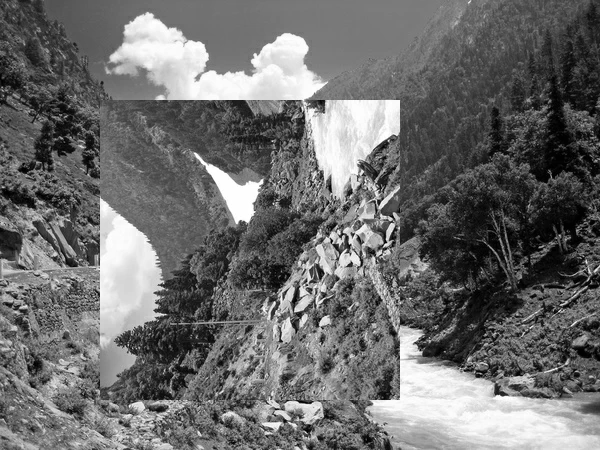

In [13]:
# convert image to grayscale
converted_image = original_image.convert(mode="L")
print("Mode: ", converted_image.mode)
converted_image

In [14]:
converted_image_cmyk = original_image.convert(mode="CMYK")
print("Mode: ", converted_image_cmyk.mode)

Mode:  CMYK


## Save image

In [15]:
converted_image_cmyk.save("converted_image.jpg", "JPEG")

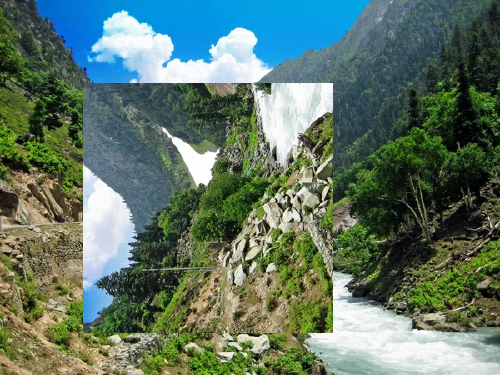

In [16]:
original_image.thumbnail((500, 500), resample=4)
original_image

## **Filter**

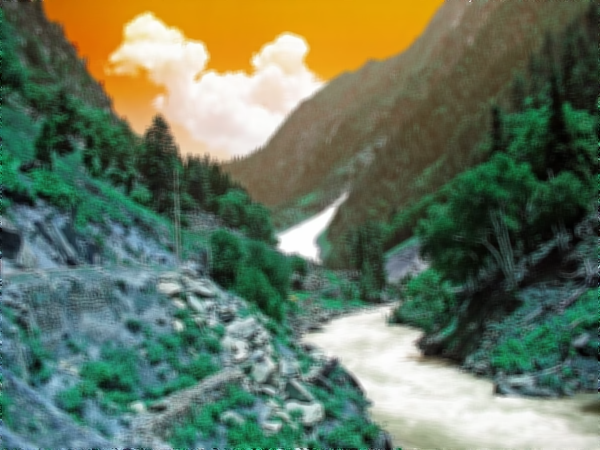

In [17]:
from PIL import ImageFilter
blur_image = merged_image_gbr.filter(ImageFilter.BLUR)
blur_image

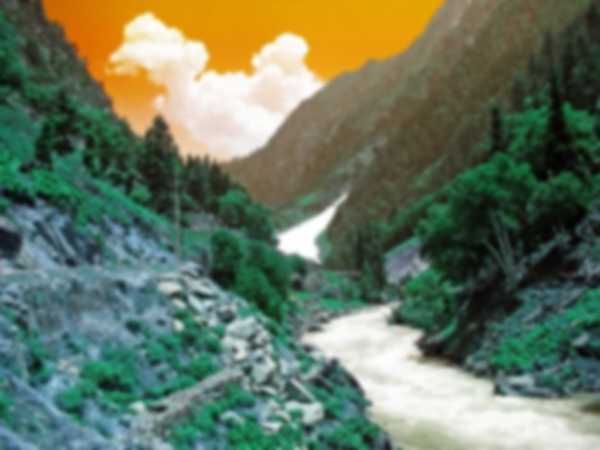

In [18]:
radius_blur = merged_image_gbr.filter(ImageFilter.GaussianBlur(radius=2))
radius_blur

## **Creating Watermark**

In [19]:
from PIL import ImageDraw, ImageFont

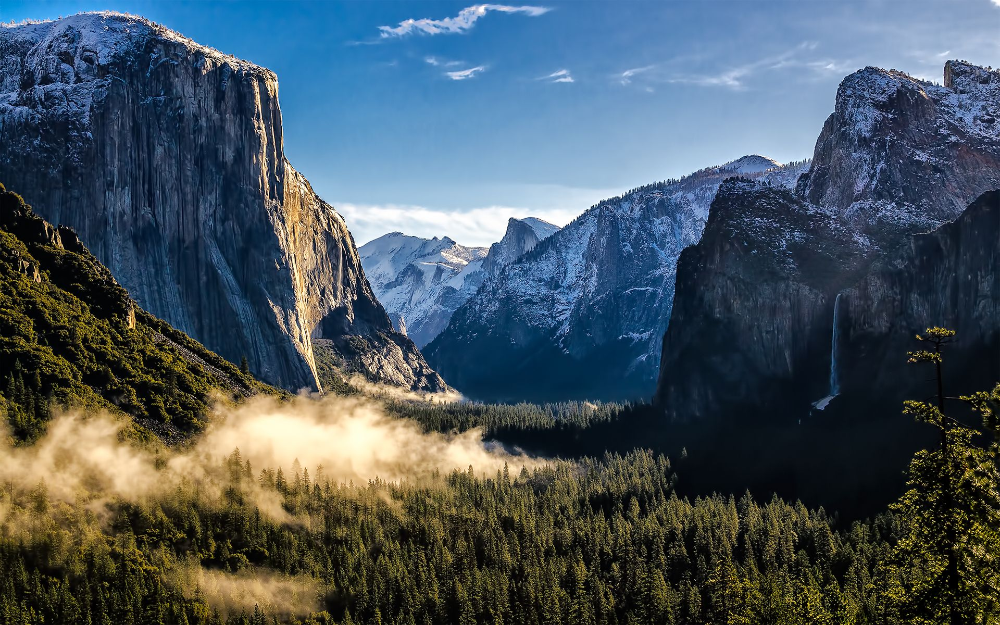

In [20]:
nature_path = get_file("https://i.pinimg.com/originals/e5/60/54/e56054ac4fc07a5477d815d47a76d4ae.jpg")
nature_image = PIL.Image.open(nature_path)
nature_image

In [21]:
draw_1 = ImageDraw.Draw(nature_image)
watermark_text = "Natural Image"
font_size = 60
font = ImageFont.load_default()

# Get the bounding box of the text
bbox = draw_1.textbbox((0, 0), watermark_text, font=font)

# Extract the width and height from the bounding box
text_width = bbox[2] - bbox[0]
text_height = bbox[3] - bbox[1]

print("Text Width:", text_width)
print("Text Height:", text_height)


Text Width: 78
Text Height: 11


In [22]:
# position of z, y coordinate of text
x, y =10, 20
draw_1.text((x, y), watermark_text, font=font)

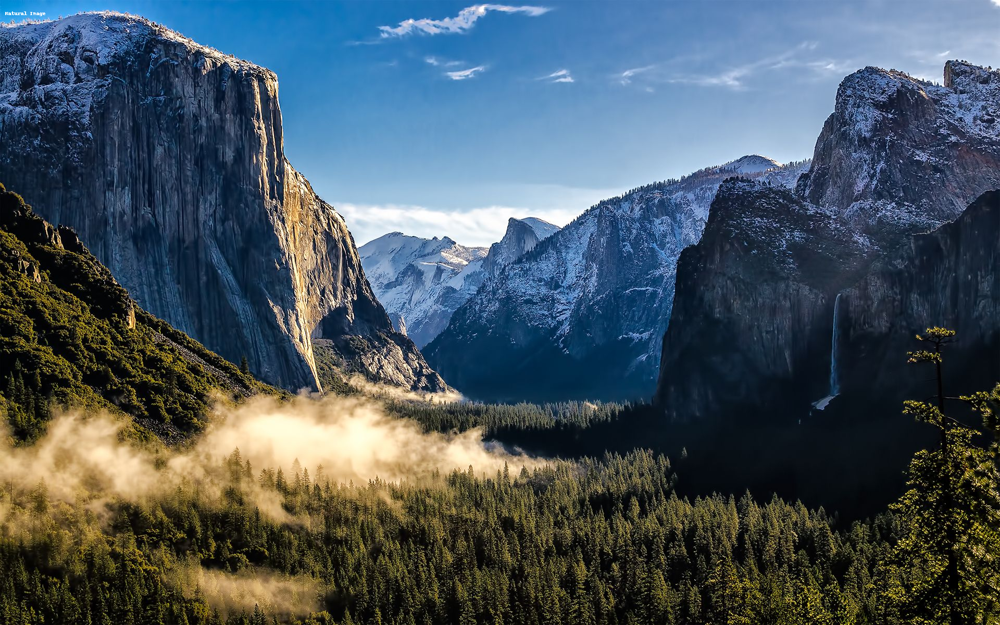

In [23]:
nature_image

In [24]:
# convert color into tuple
PIL.ImageColor.getrgb("red")

(255, 0, 0)

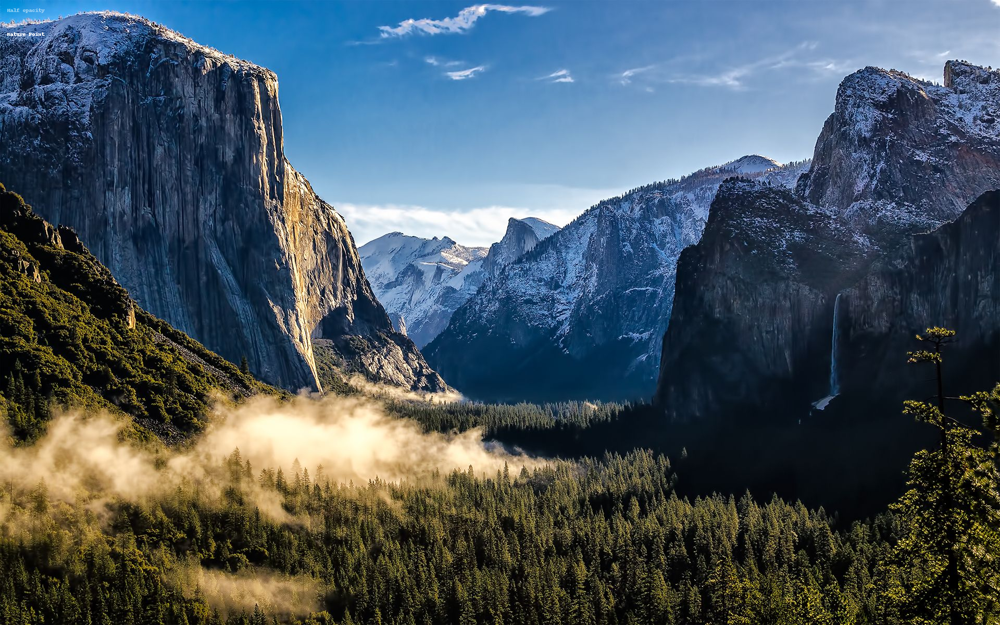

In [25]:
from PIL import Image, ImageDraw, ImageFont

# get an image
img = Image.open(nature_path).convert('RGBA')

# making a blank image for the text, initialized to transparent text color
text1 = Image.new('RGBA', img.size, (255,255,255,0))

# getting a font from the saved library
fnt = ImageFont.load_default()
d = ImageDraw.Draw(text1)

# draw text with the half opacity
d.text((14,14), "Half opacity", font=fnt, fill=(255,255,255,128))

# draw text with the  full opacity
d.text((14,60), "Nature Point", font=fnt, fill=(255,255,255,255))
out = Image.alpha_composite(img, text1)

out